In [ ]:
# Mount Google Drive with Colab
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
# Importing Libraries
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import os
import tensorflow as tf
from PIL import Image, ImageFile
from tensorflow.keras.preprocessing.image import ImageDataGenerator

In [ ]:
# Preventing errors with truncated images
ImageFile.LOAD_TRUNCATED_IMAGES = True

# Function to remove corrupted images
def removeCorruptedImages(path):
    for filename in os.listdir(path):
        try:
            img = Image.open(os.path.join(path,filename))
            img.verify()
        except (IOError, SyntaxError) as e:
            print('Bad file:', filename)
            os.remove(os.path.join(path,filename))

In [ ]:
# Setting up directories
basedir = "/content/drive/MyDrive/DATASET"
traindir = os.path.join(basedir, 'TRAIN')
validdir = os.path.join(basedir, 'TEST')

# Removing corrupted images
classes = ['downdog', 'goddess', 'plank', 'tree', 'warrior2']
for cls in classes:
    removeCorruptedImages(os.path.join(traindir, cls))
    removeCorruptedImages(os.path.join(validdir, cls))

In [ ]:
# Preparing Data Generators
train_datagen = ImageDataGenerator(rescale = 1./255, shear_range = 0.2, zoom_range = 0.2, horizontal_flip = True)
test_datagen = ImageDataGenerator(rescale = 1./255)

bx = 16

train_generator = train_datagen.flow_from_directory(traindir, target_size = (300, 300), batch_size = bx, class_mode = 'categorical')
valid_generator = test_datagen.flow_from_directory(validdir, target_size = (300, 300), batch_size = bx, class_mode = 'categorical')

Found 1081 images belonging to 5 classes.
Found 475 images belonging to 5 classes.


In [ ]:
from tensorflow.keras.models import Sequential, Model
from tensorflow.keras.layers import Flatten, Dense, Activation, Dropout, Conv2D, MaxPooling2D
from tensorflow.keras.applications import Xception

# Building the model
base_model = Xception(weights = '/content/drive/MyDrive/DATASET/xception_weights_tf_dim_ordering_tf_kernels_notop.h5',
                      include_top = False,
                      input_shape = (300, 300, 3))

model = Sequential([
    Flatten(input_shape = base_model.output_shape[1:]),
    Dense(128, activation = 'relu'),
    Dropout(0.2),
    # Dropout(0.5),
    Dense(5, activation = 'softmax')
])

model = Model(inputs = base_model.input, outputs = model(base_model.output))

In [ ]:
# Compiling the model
model.compile(optimizer=tf.keras.optimizers.SGD(learning_rate = 0.0001, momentum = 0.9, nesterov = True),
              loss=tf.keras.losses.CategoricalCrossentropy(label_smoothing = 0.2, from_logits = True),
              metrics=['accuracy'])

model.summary()

Model: "model"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_1 (InputLayer)        [(None, 300, 300, 3)]        0         []                            
                                                                                                  
 block1_conv1 (Conv2D)       (None, 149, 149, 32)         864       ['input_1[0][0]']             
                                                                                                  
 block1_conv1_bn (BatchNorm  (None, 149, 149, 32)         128       ['block1_conv1[0][0]']        
 alization)                                                                                       
                                                                                                  
 block1_conv1_act (Activati  (None, 149, 149, 32)         0         ['block1_conv1_bn[0][0]'] 

In [ ]:
# Training the model
hist = model.fit(train_generator, validation_data = valid_generator, epochs = 15)

Epoch 1/15


/usr/local/lib/python3.10/dist-packages/keras/src/backend.py:5575: UserWarning: "`categorical_crossentropy` received `from_logits=True`, but the `output` argument was produced by a Softmax activation and thus does not represent logits. Was this intended?
  output, from_logits = _get_logits(
/usr/local/lib/python3.10/dist-packages/PIL/Image.py:1000: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  warnings.warn(


68/68 [==============================] - 199s 3s/step - loss: 1.2900 - accuracy: 0.5634 - val_loss: 0.9770 - val_accuracy: 0.8316
Epoch 2/15
68/68 [==============================] - 173s 3s/step - loss: 0.9794 - accuracy: 0.8344 - val_loss: 0.8436 - val_accuracy: 0.9305
Epoch 3/15
68/68 [==============================] - 172s 3s/step - loss: 0.9327 - accuracy: 0.8714 - val_loss: 0.8227 - val_accuracy: 0.9389
Epoch 4/15
68/68 [==============================] - 172s 3s/step - loss: 0.8736 - accuracy: 0.9149 - val_loss: 0.8109 - val_accuracy: 0.9453
Epoch 5/15
68/68 [==============================] - 171s 3s/step - loss: 0.8497 - accuracy: 0.9232 - val_loss: 0.8001 - val_accuracy: 0.9516
Epoch 6/15
68/68 [==============================] - 170s 2s/step - loss: 0.8342 - accuracy: 0.9380 - val_loss: 0.8189 - val_accuracy: 0.9368
Epoch 7/15
68/68 [==============================] - 171s 3s/step - loss: 0.8082 - accuracy: 0.9584 - val_loss: 0.7896 - val_accuracy: 0.9621
Epoch 8/15
68/68 [======

In [ ]:
# Evaluating the model
val_loss, val_accuracy = model.evaluate(valid_generator)
print(f'Validation loss: {val_loss}')
print(f'Validation accuracy: {val_accuracy}')

30/30 [==============================] - 14s 470ms/step - loss: 0.7689 - accuracy: 0.9663
Validation loss: 0.7688654065132141
Validation accuracy: 0.9663158059120178


In [ ]:
# Saving the model
model.save("/content/drive/MyDrive/DATASET/Yoga_Pose_Classification_Model.h5")

/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


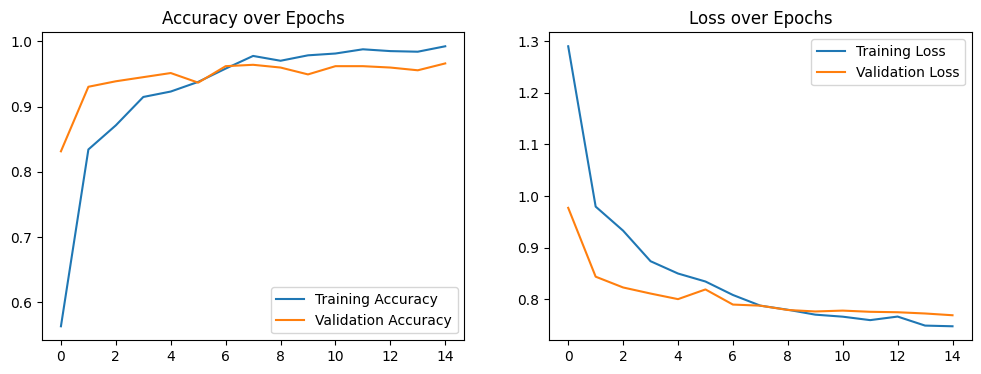

In [ ]:
# Visualizing training results
plt.figure(figsize = (12, 4))
plt.subplot(1, 2, 1)
plt.plot(hist.history['accuracy'], label = 'Training Accuracy')
plt.plot(hist.history['val_accuracy'], label = 'Validation Accuracy')
plt.legend()
plt.title('Accuracy over Epochs')

plt.subplot(1, 2, 2)
plt.plot(hist.history['loss'], label = 'Training Loss')
plt.plot(hist.history['val_loss'], label = 'Validation Loss')
plt.legend()
plt.title('Loss over Epochs')

plt.show()

In [ ]:

import tensorflow as tf
from tensorflow.keras.models import load_model
from tensorflow.keras.preprocessing.image import ImageDataGenerator

# Load the saved model
model_path = "/content/drive/MyDrive/DATASET/Yoga_Pose_Classification_Model.h5"
model = load_model(model_path)

# Set up the directory for test data
testdir = "/content/drive/MyDrive/DATASET/TEST"

# Preprocess the test data
test_datagen = ImageDataGenerator(rescale=1./255)

# Load the test data
bx = 16
test_generator = test_datagen.flow_from_directory(
    testdir,
    target_size=(300, 300),
    batch_size=bx,
    class_mode='categorical',
    shuffle=False
)

# Evaluate the model on the test data
test_loss, test_accuracy = model.evaluate(test_generator)
print(f'Test loss: {test_loss}')
print(f'Test accuracy: {test_accuracy}')

# Make predictions on the test data
predictions = model.predict(test_generator)

# Get the predicted class labels
predicted_classes = tf.argmax(predictions, axis=1)

# Get the true class labels
true_classes = test_generator.classes



# Print some example predictions
print("Predicted classes:", predicted_classes[:10])
print("True classes:", true_classes[:10])


Found 475 images belonging to 5 classes.
30/30 [==============================] - 223s 7s/step - loss: 0.7689 - accuracy: 0.9663
Test loss: 0.7688655853271484
Test accuracy: 0.9663158059120178
30/30 [==============================] - 207s 7s/step
Predicted classes: tf.Tensor([0 0 0 0 0 0 0 0 0 0], shape=(10,), dtype=int64)
True classes: [0 0 0 0 0 0 0 0 0 0]


1/1 [==============================] - 1s 1s/step


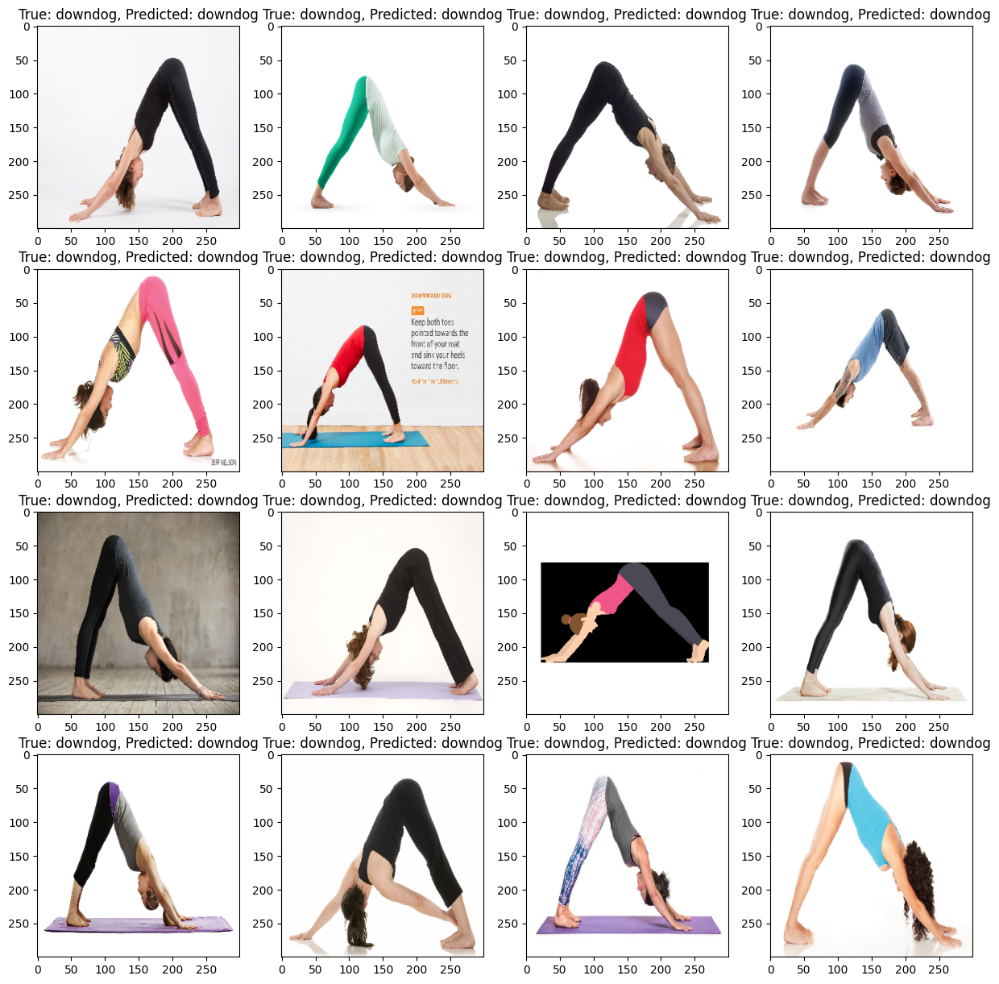

1/1 [==============================] - 0s 411ms/step


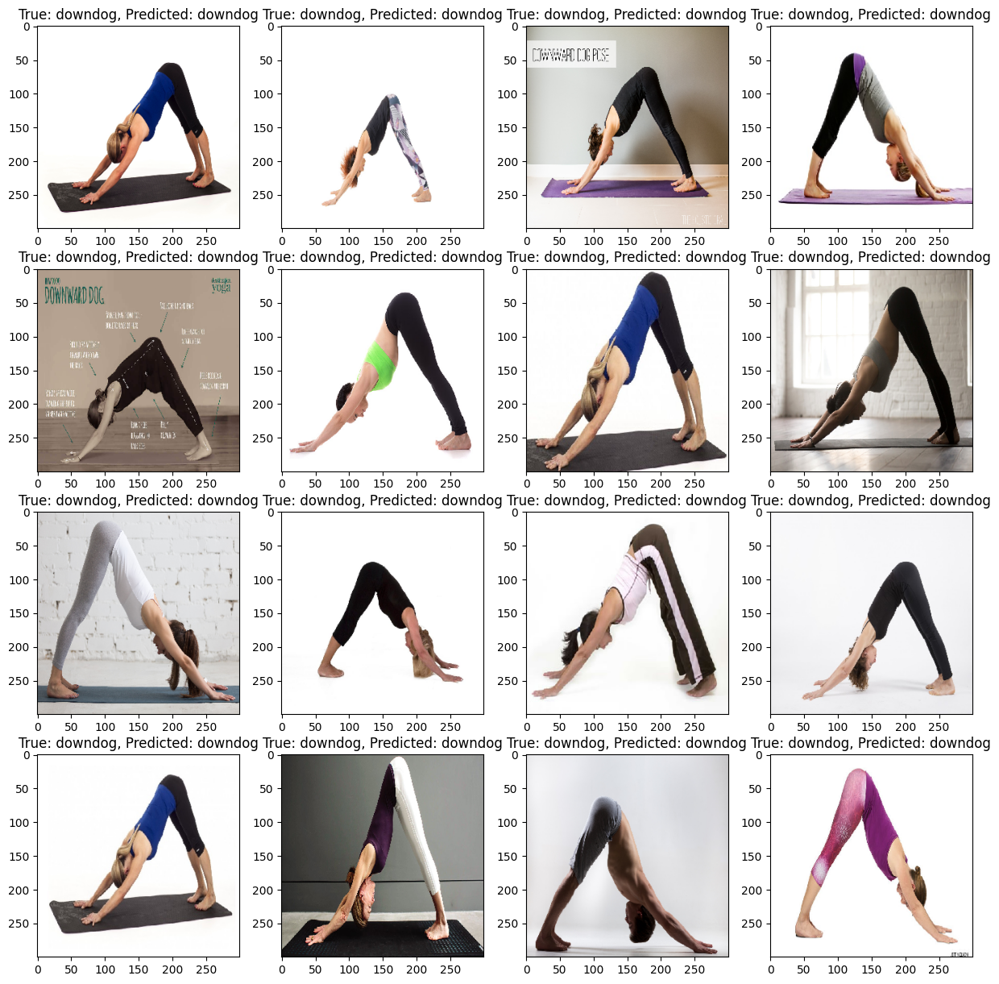

1/1 [==============================] - 0s 407ms/step


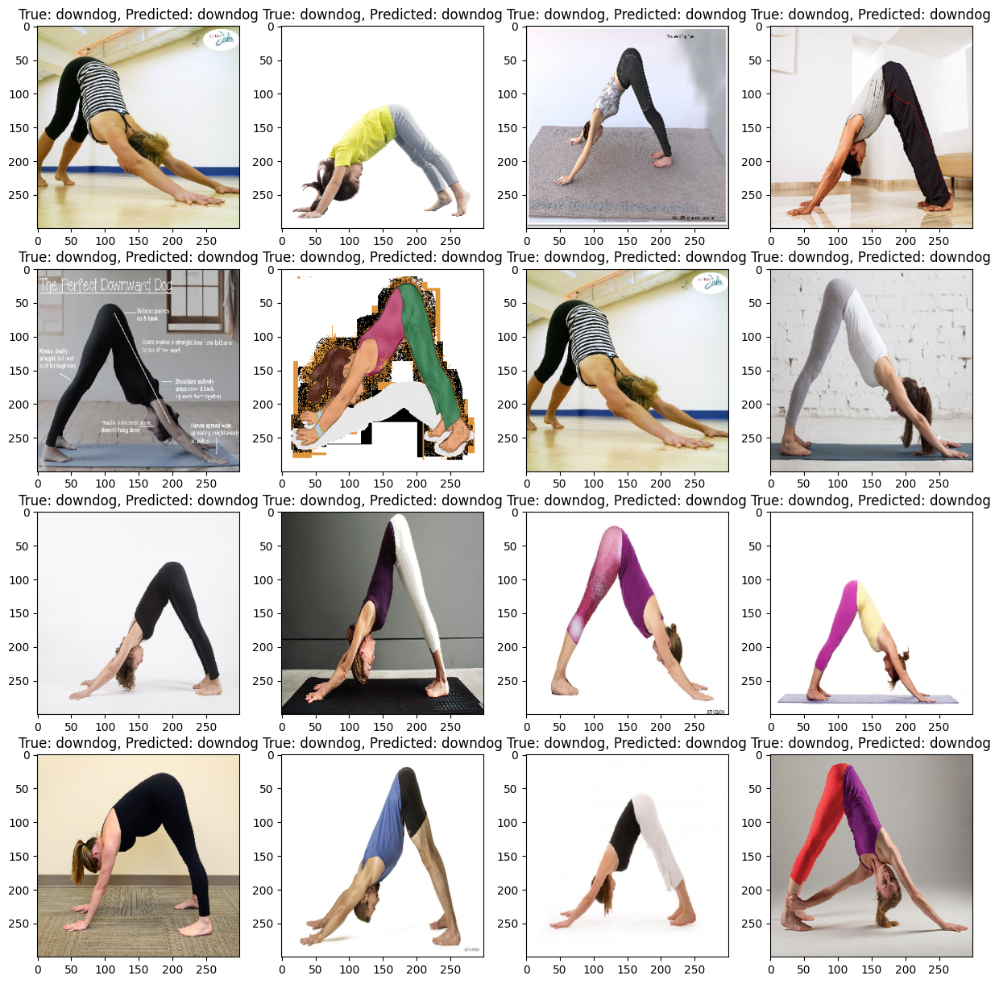

1/1 [==============================] - 0s 419ms/step


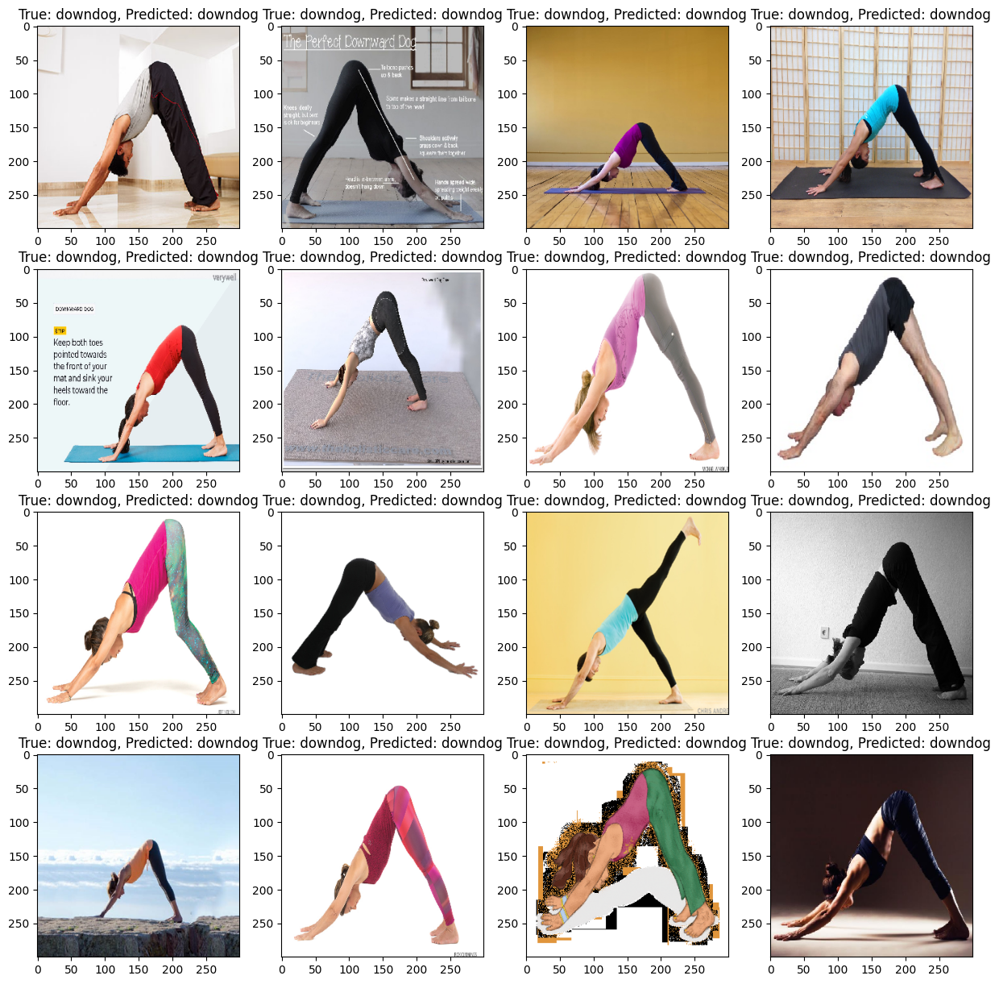

1/1 [==============================] - 0s 385ms/step


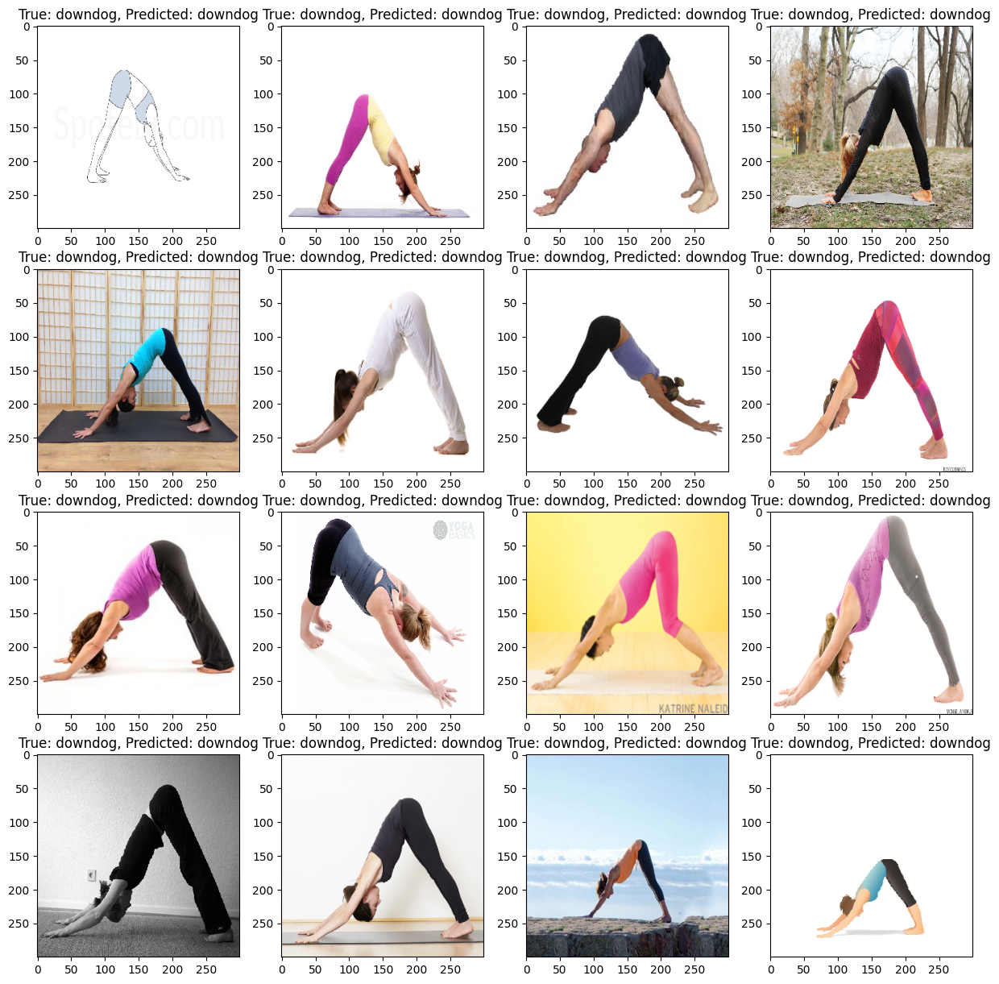

1/1 [==============================] - 0s 388ms/step


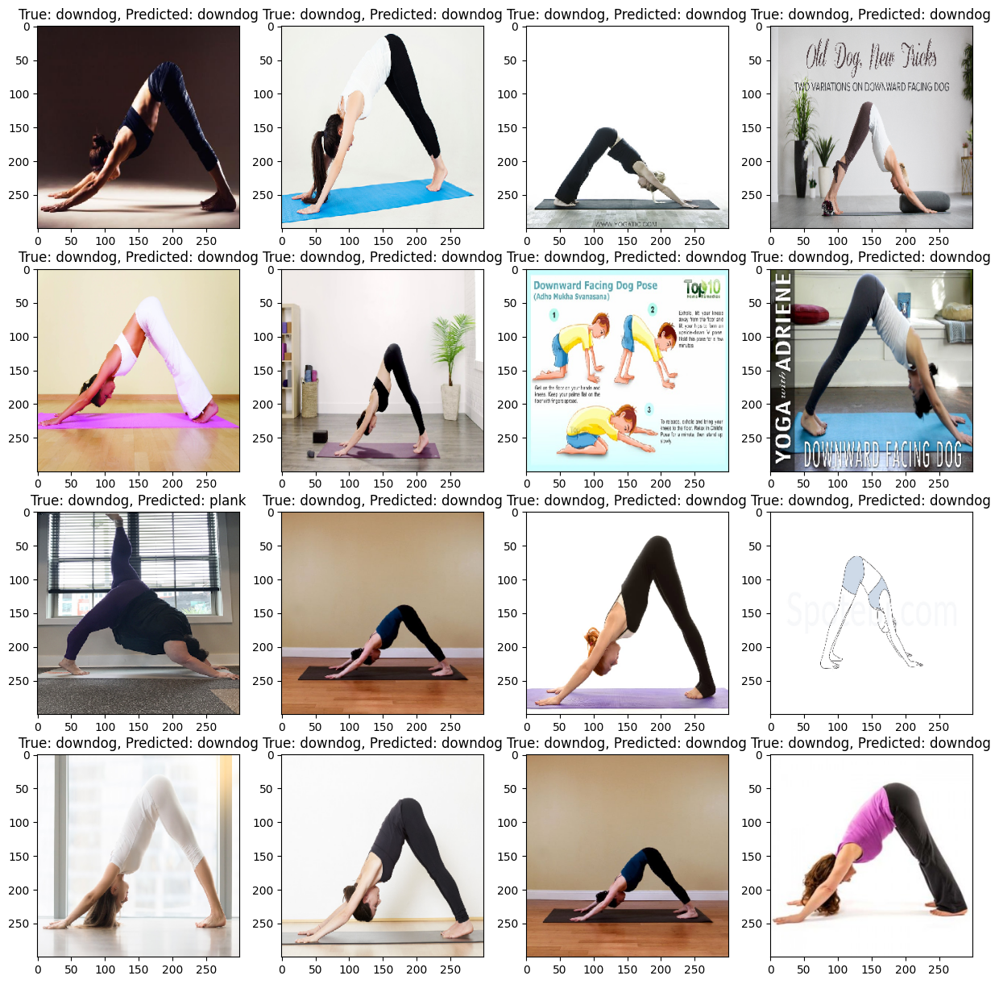

1/1 [==============================] - 0s 384ms/step


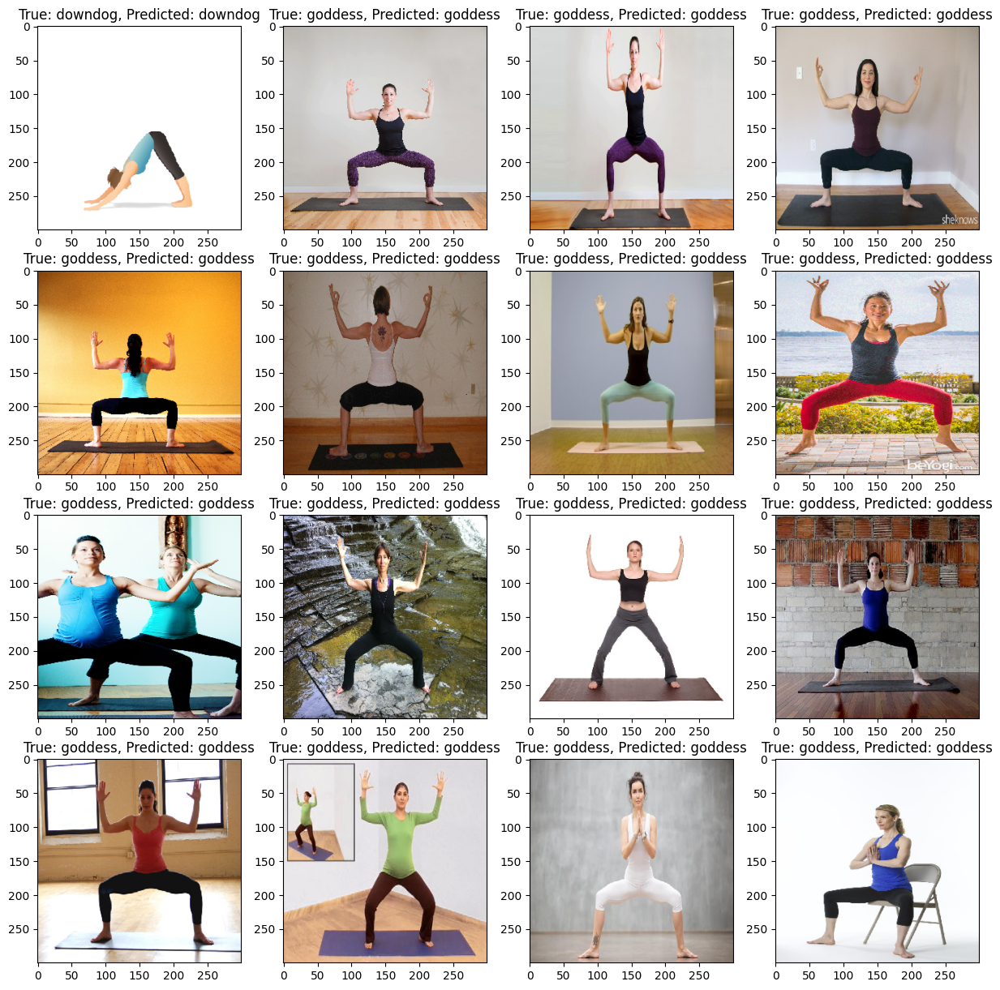

1/1 [==============================] - 0s 416ms/step


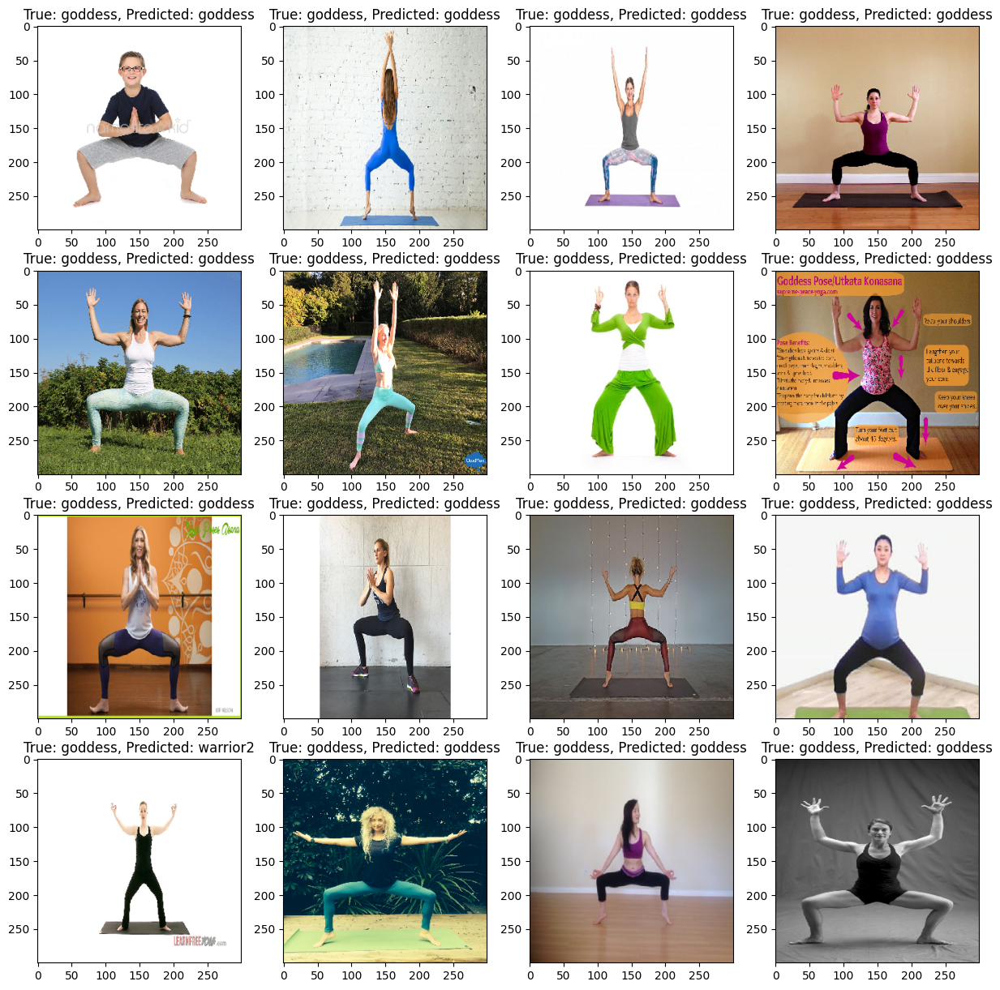

1/1 [==============================] - 0s 387ms/step


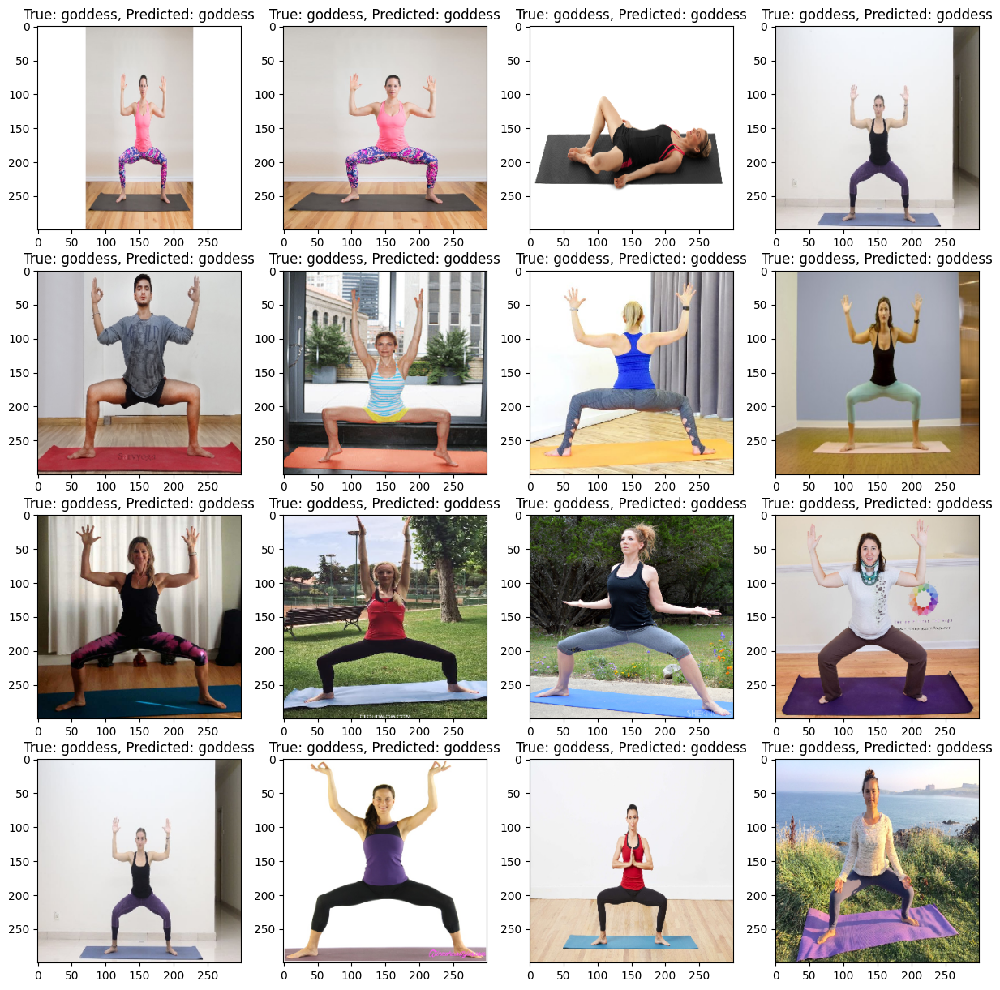

1/1 [==============================] - 0s 386ms/step


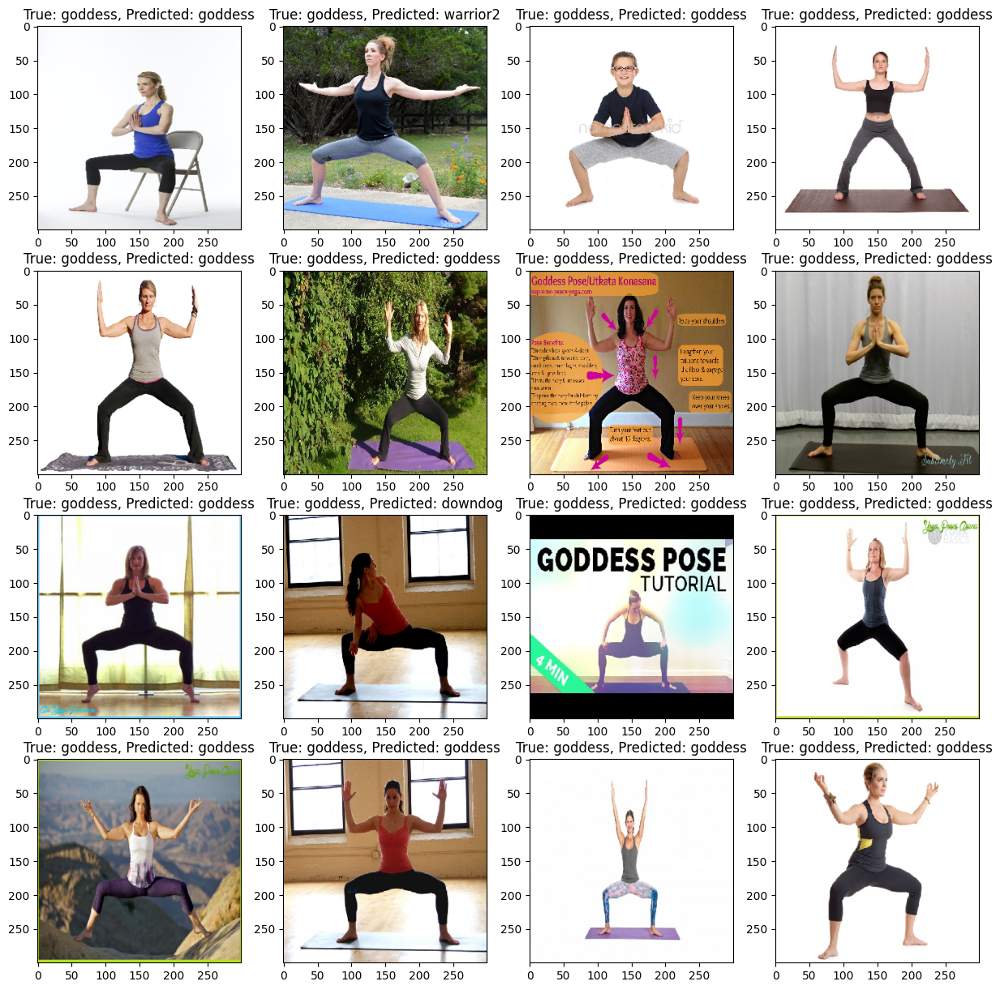

1/1 [==============================] - 0s 390ms/step


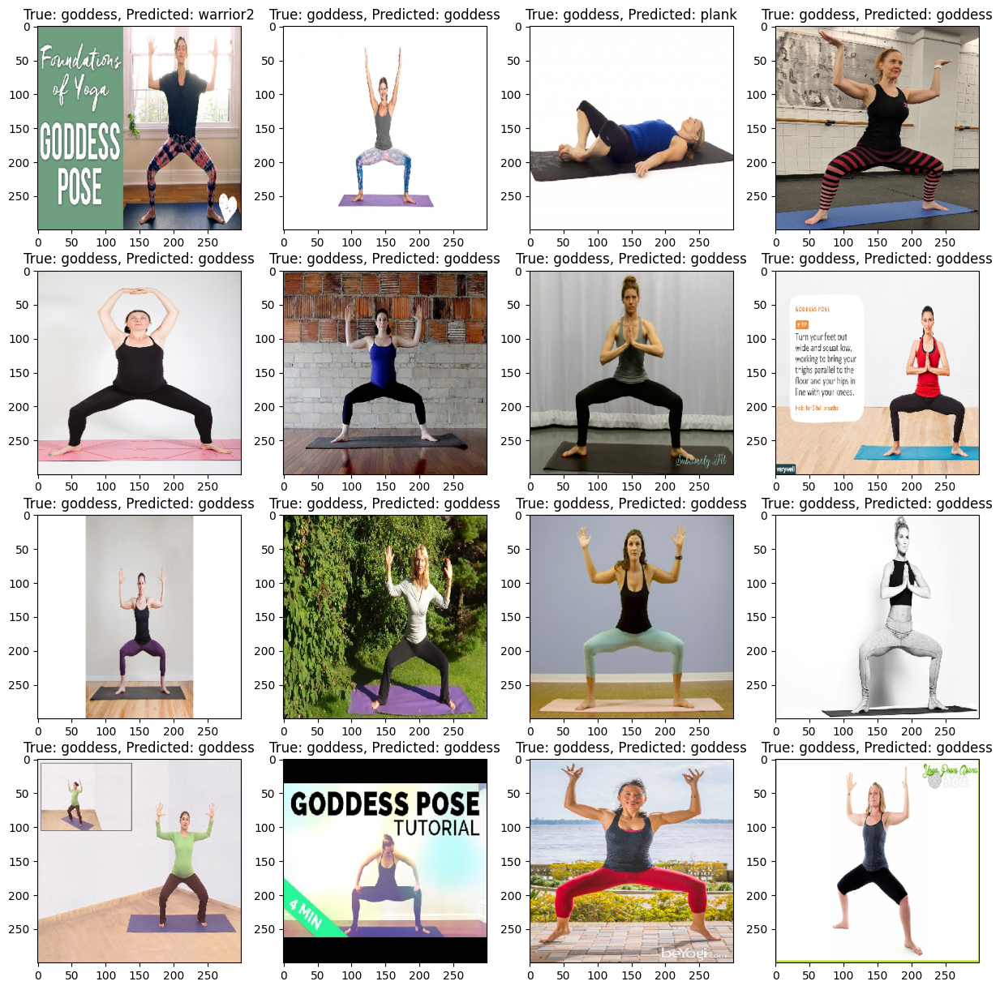

1/1 [==============================] - 0s 381ms/step


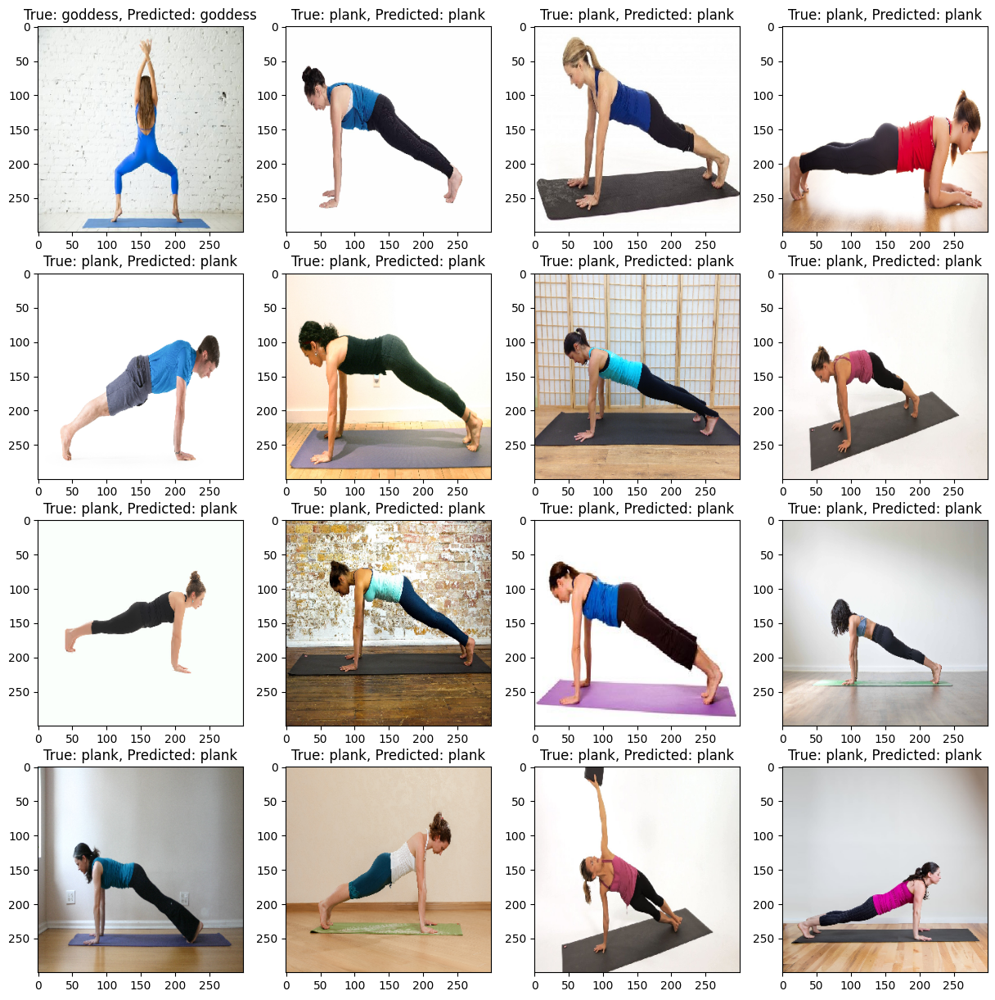

1/1 [==============================] - 0s 399ms/step


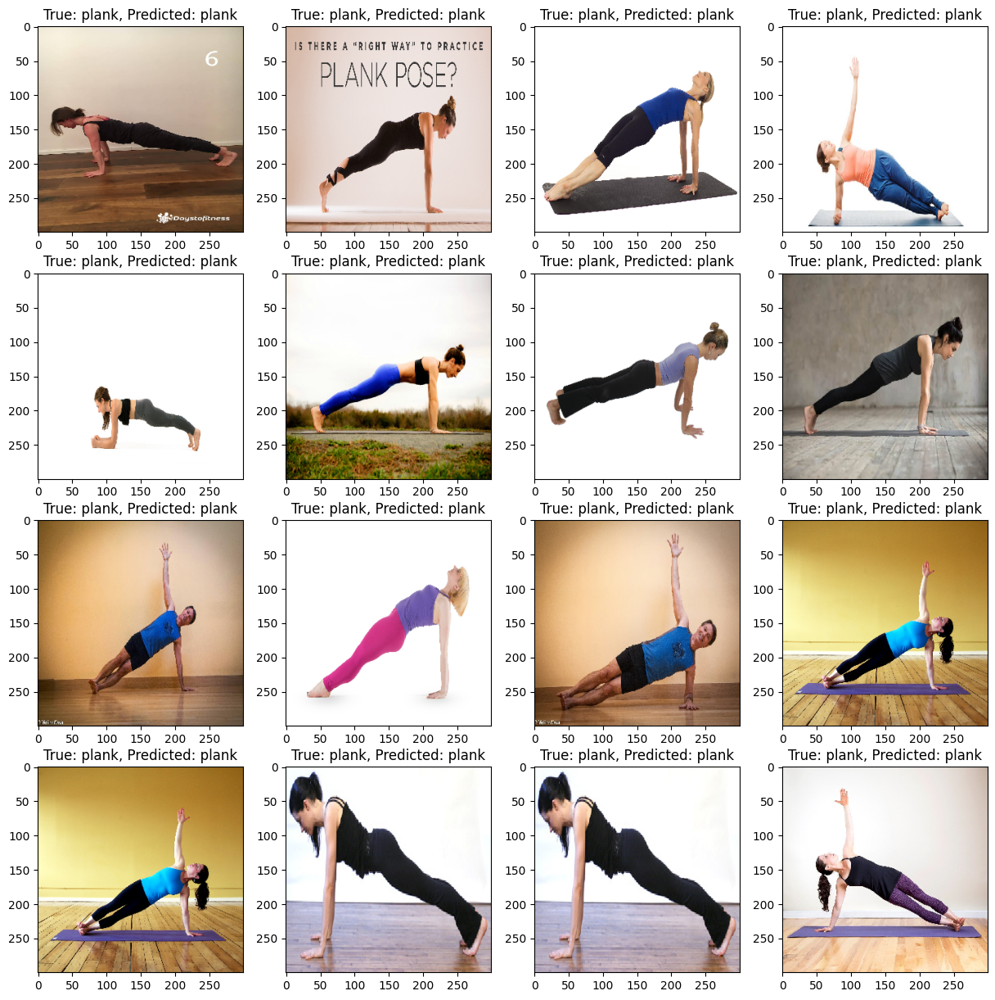

1/1 [==============================] - 0s 406ms/step


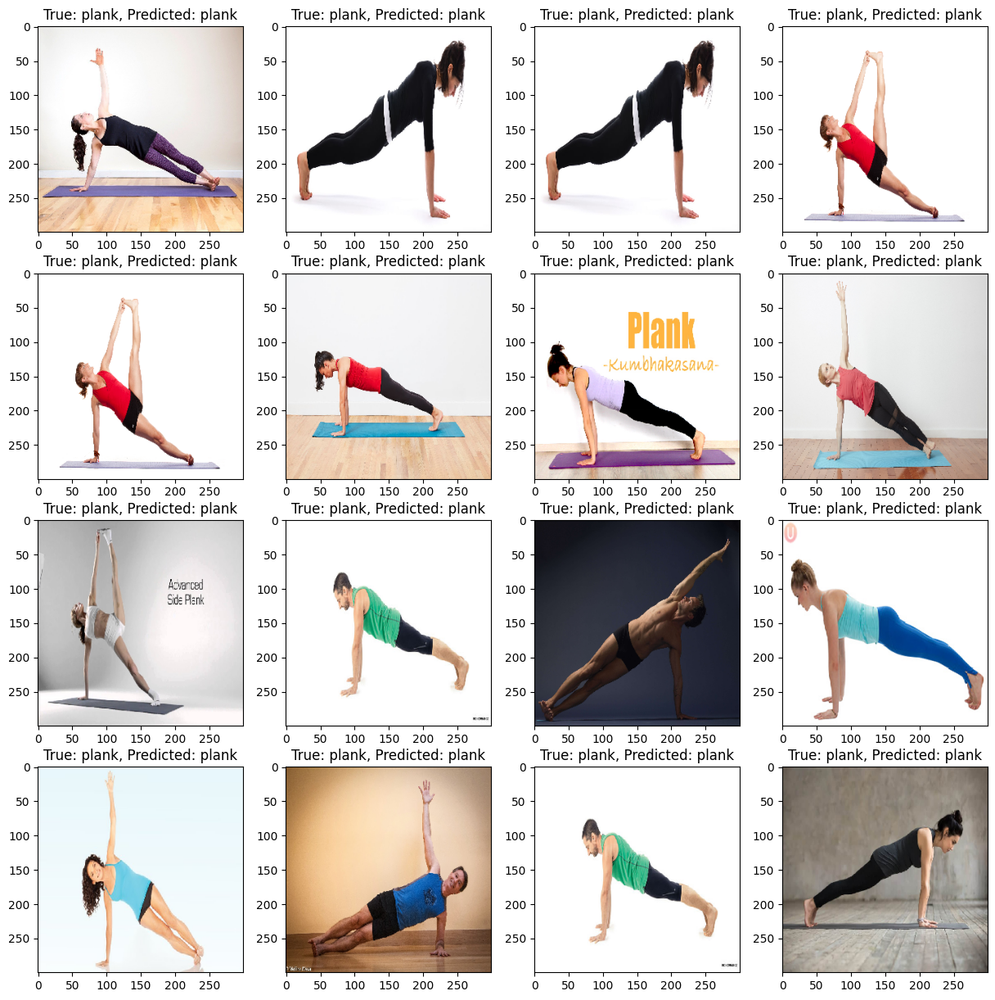

1/1 [==============================] - 0s 411ms/step


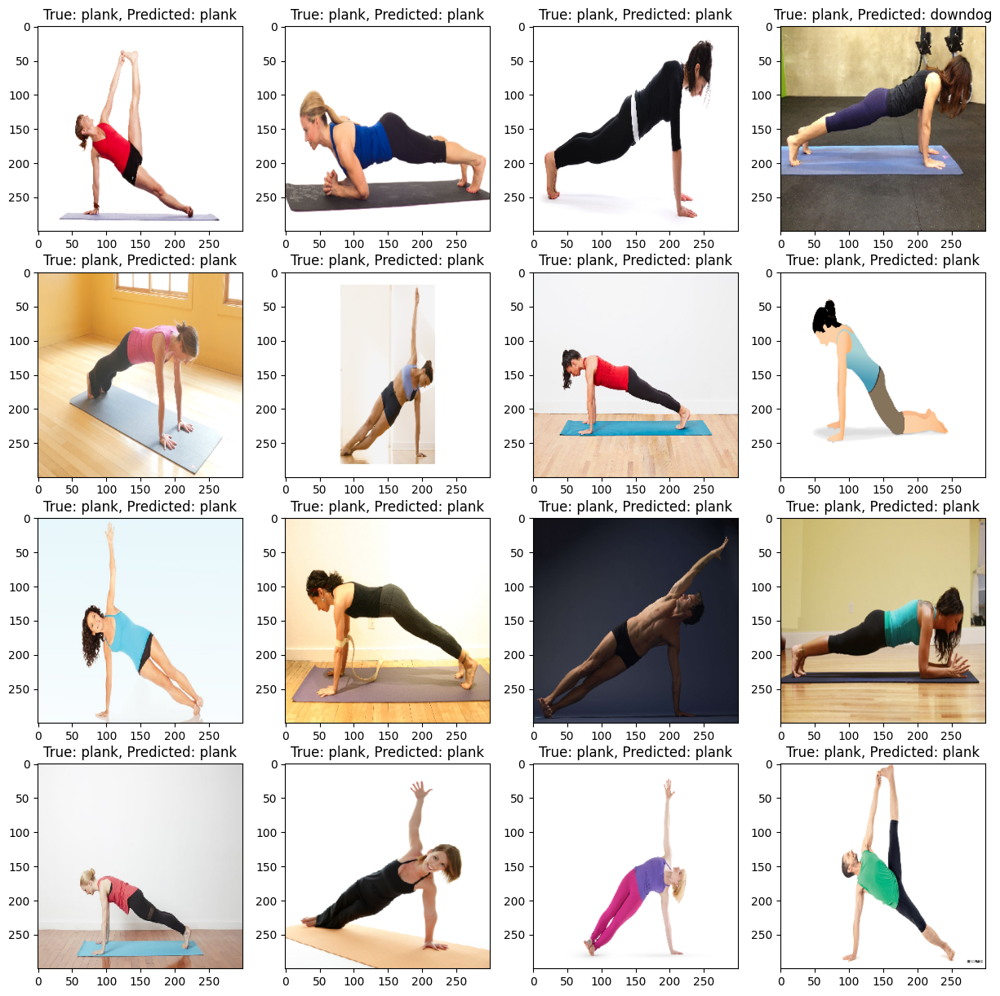

1/1 [==============================] - 0s 409ms/step


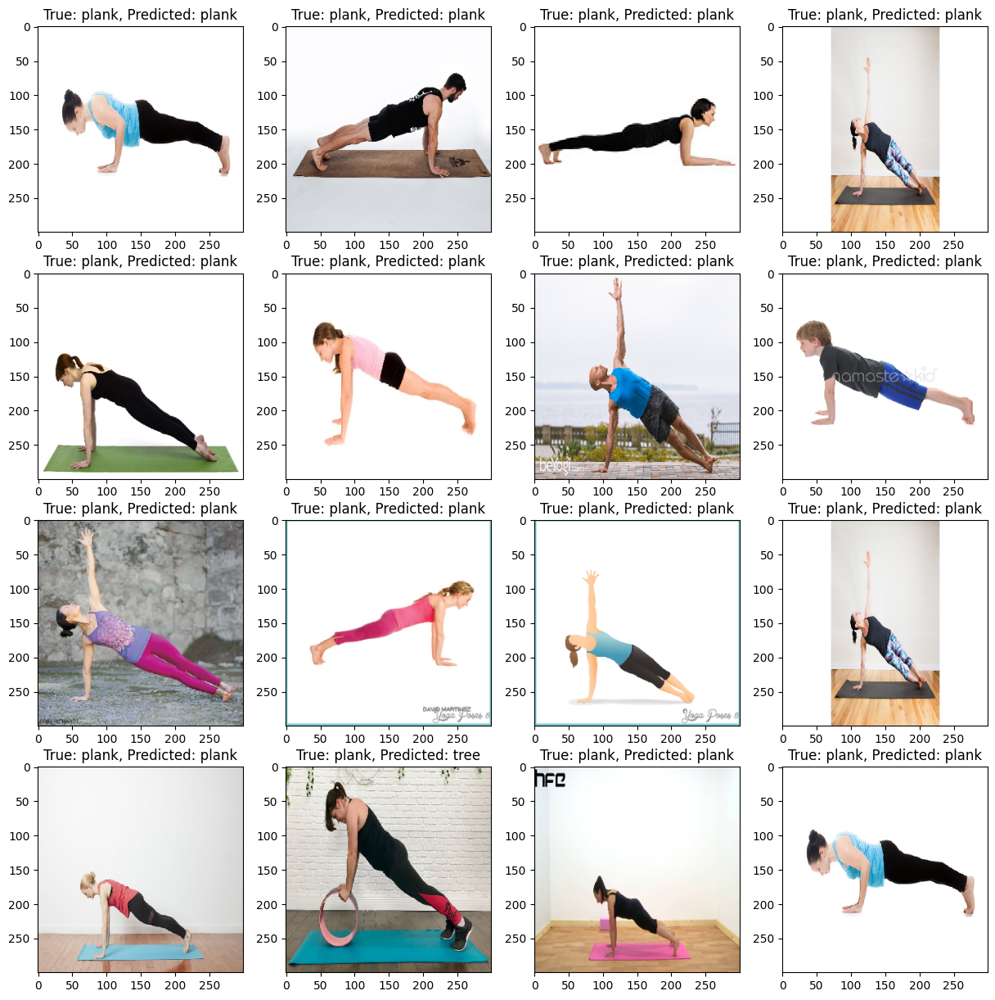

1/1 [==============================] - 0s 415ms/step


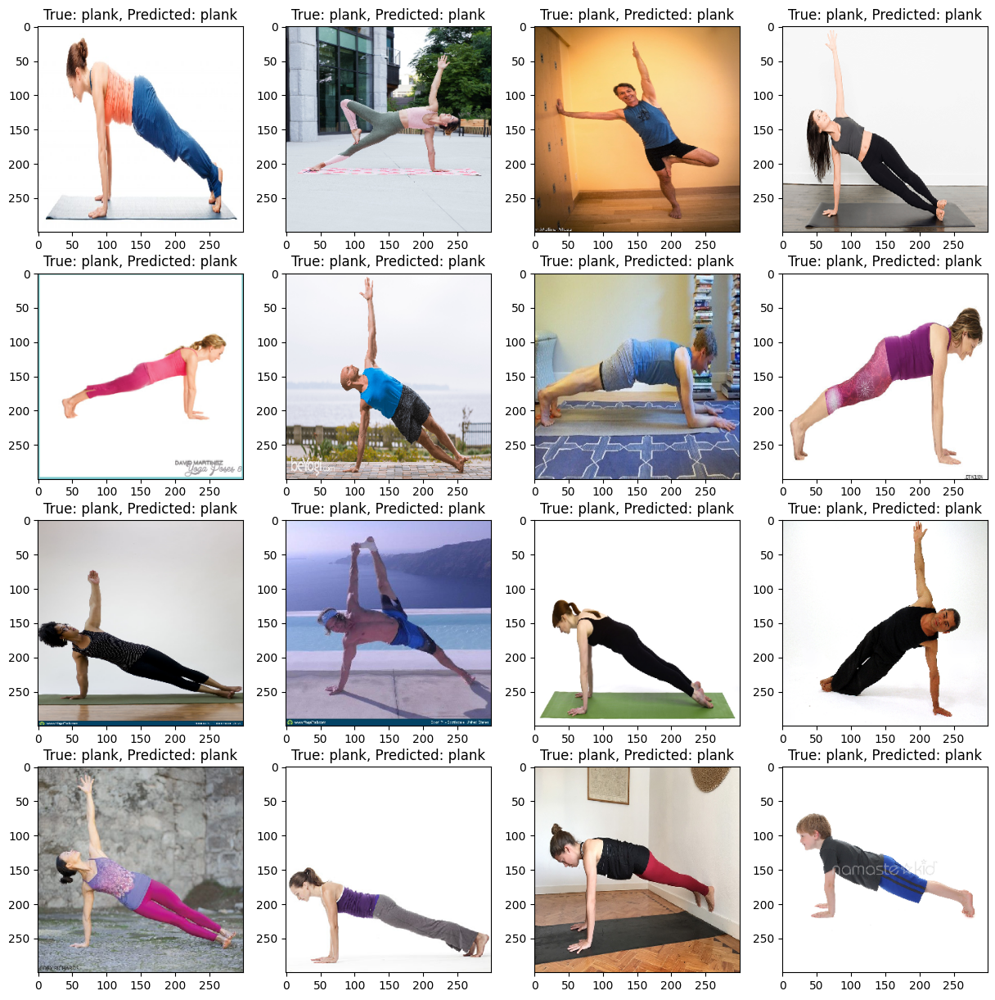

1/1 [==============================] - 0s 404ms/step


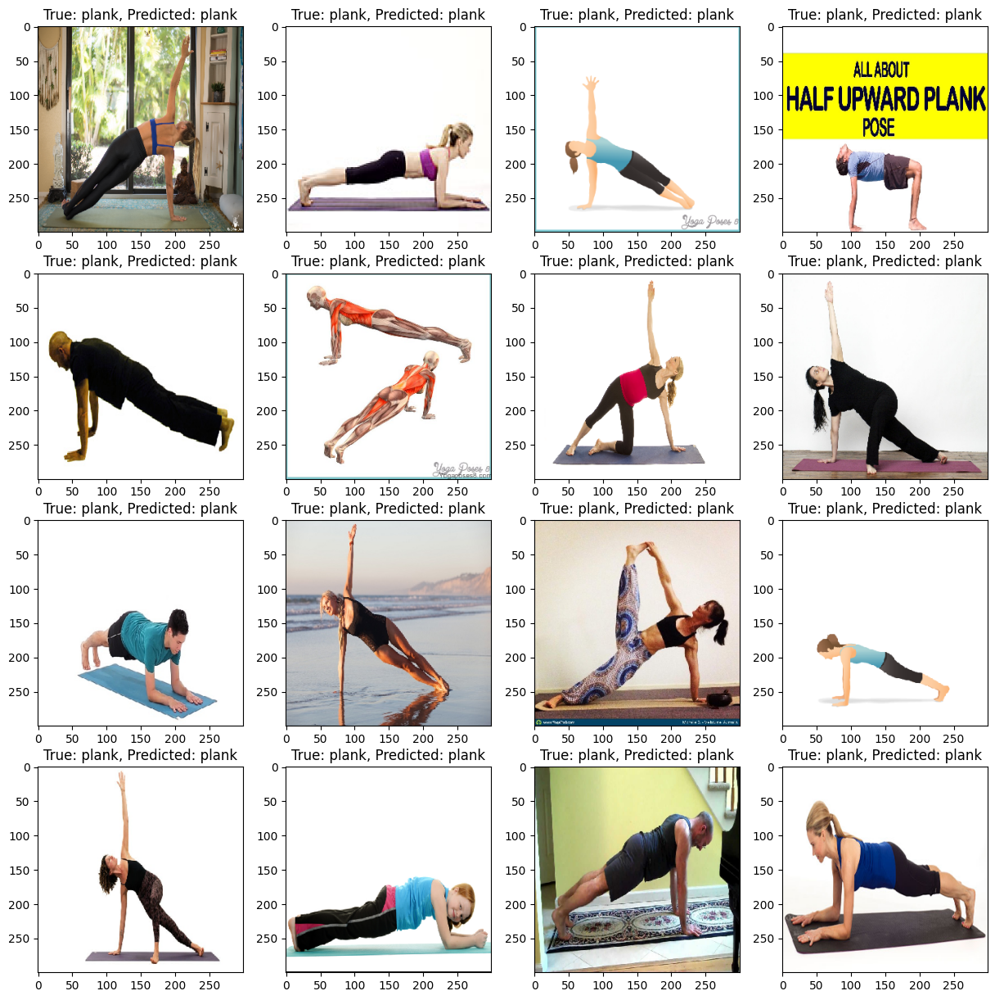

1/1 [==============================] - 0s 400ms/step


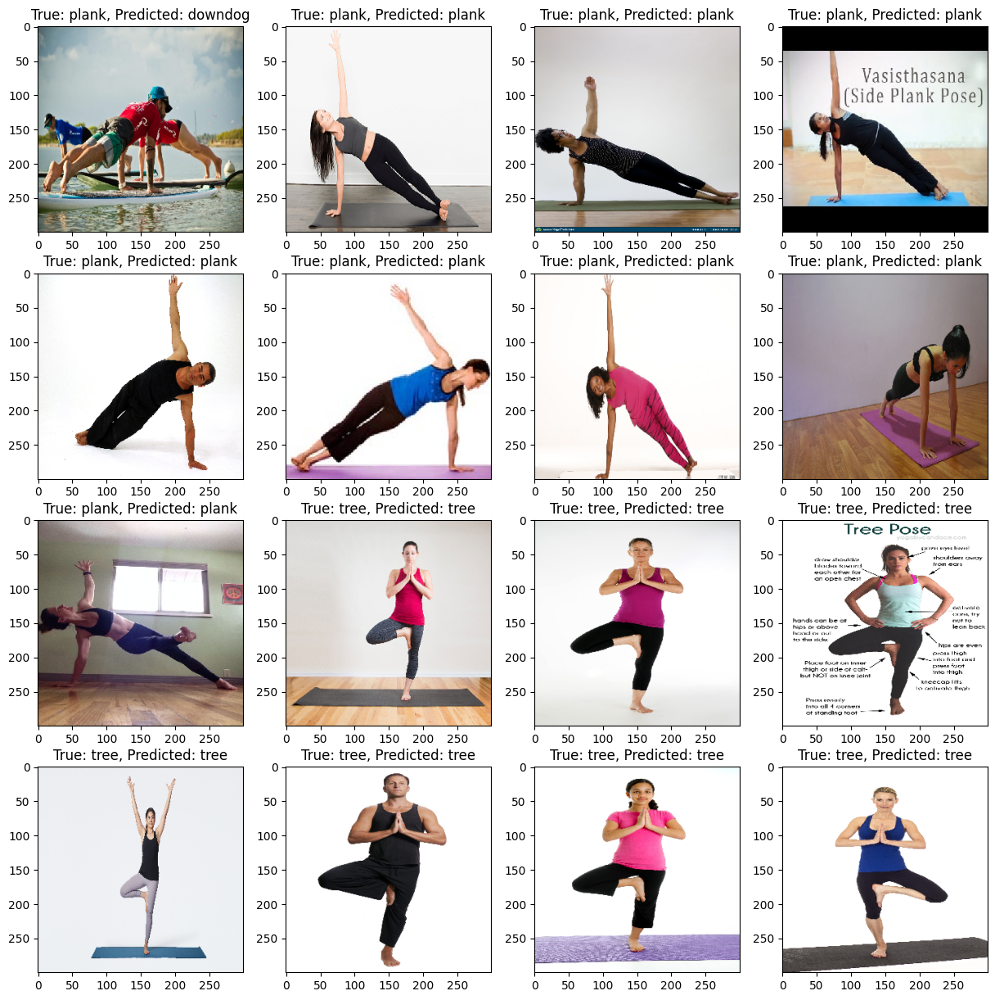

1/1 [==============================] - 0s 402ms/step


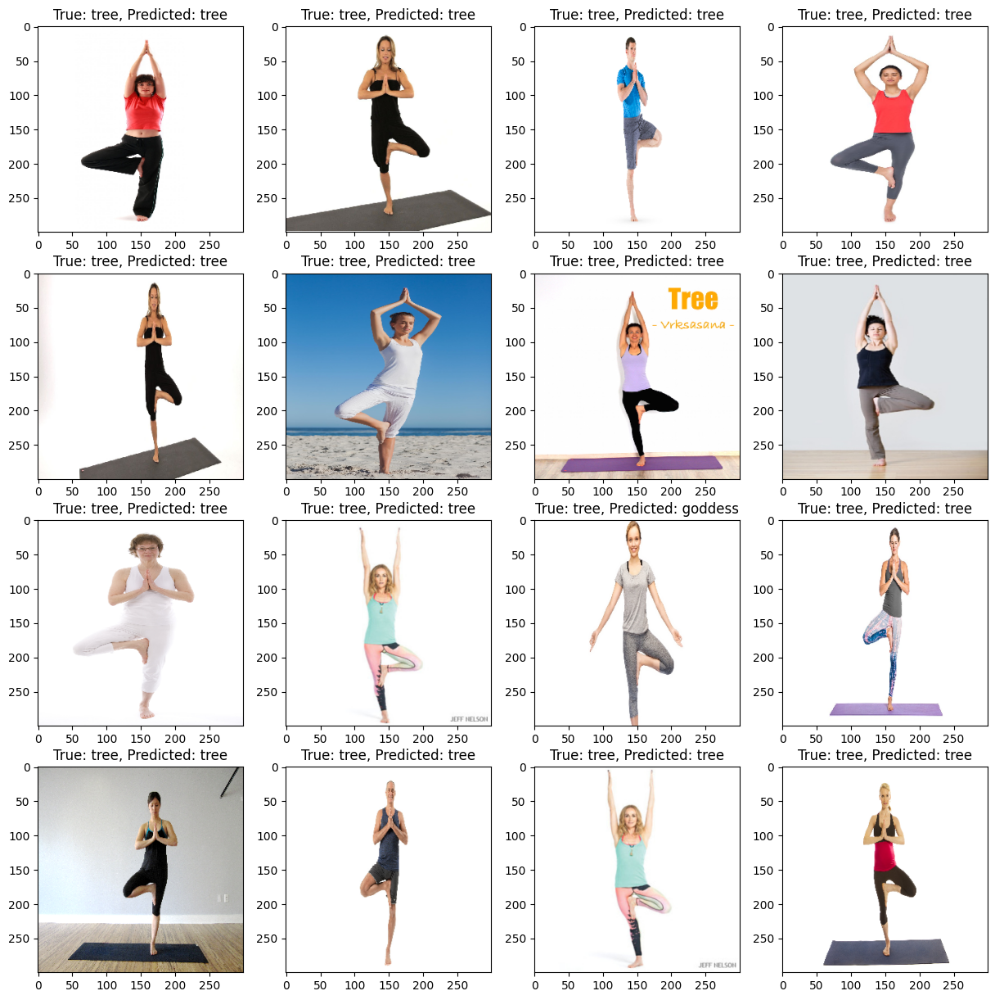

1/1 [==============================] - 0s 388ms/step


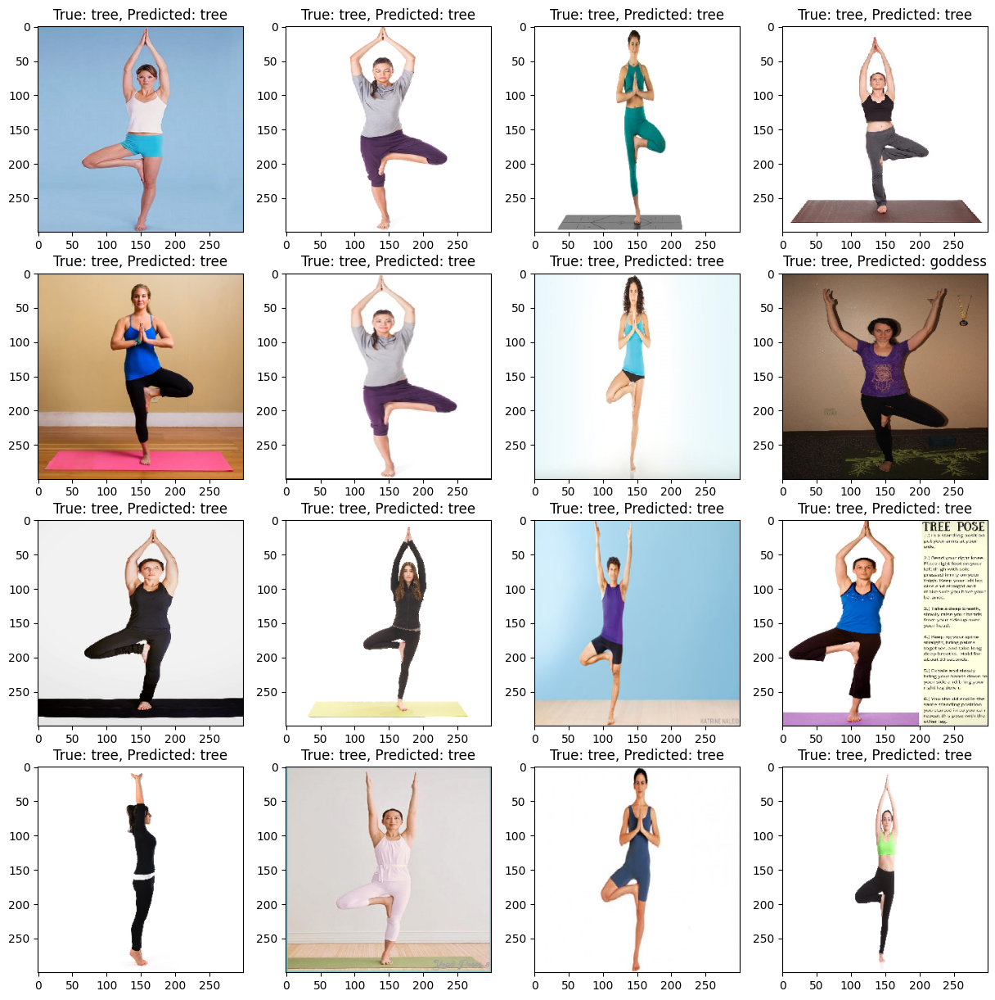

1/1 [==============================] - 0s 385ms/step


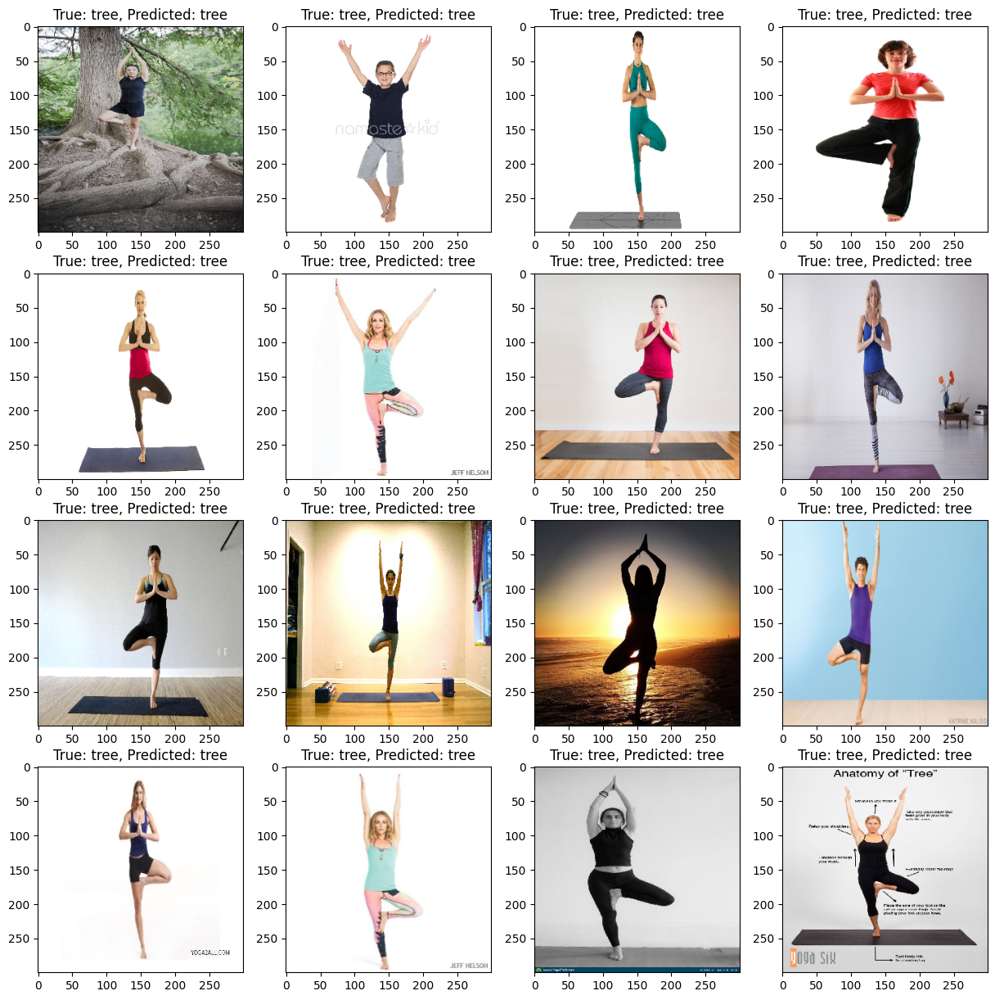

1/1 [==============================] - 0s 409ms/step


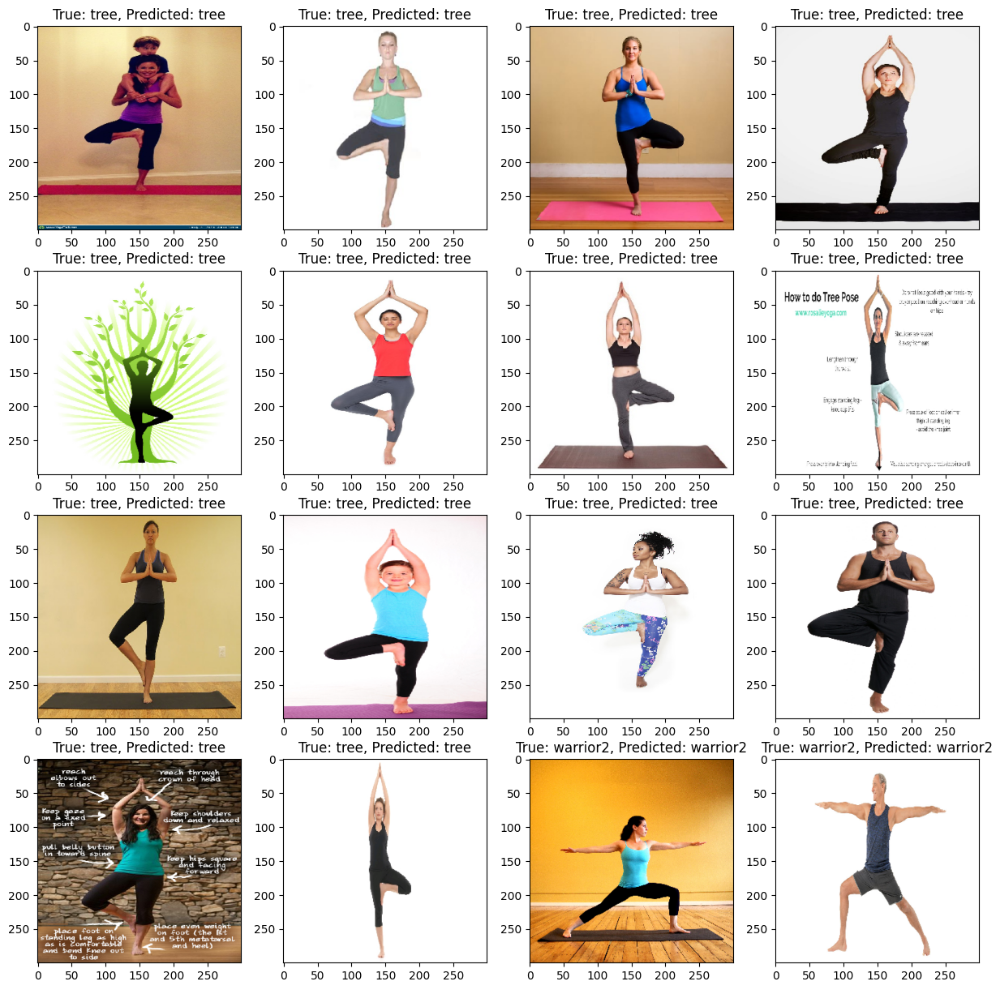

1/1 [==============================] - 0s 416ms/step


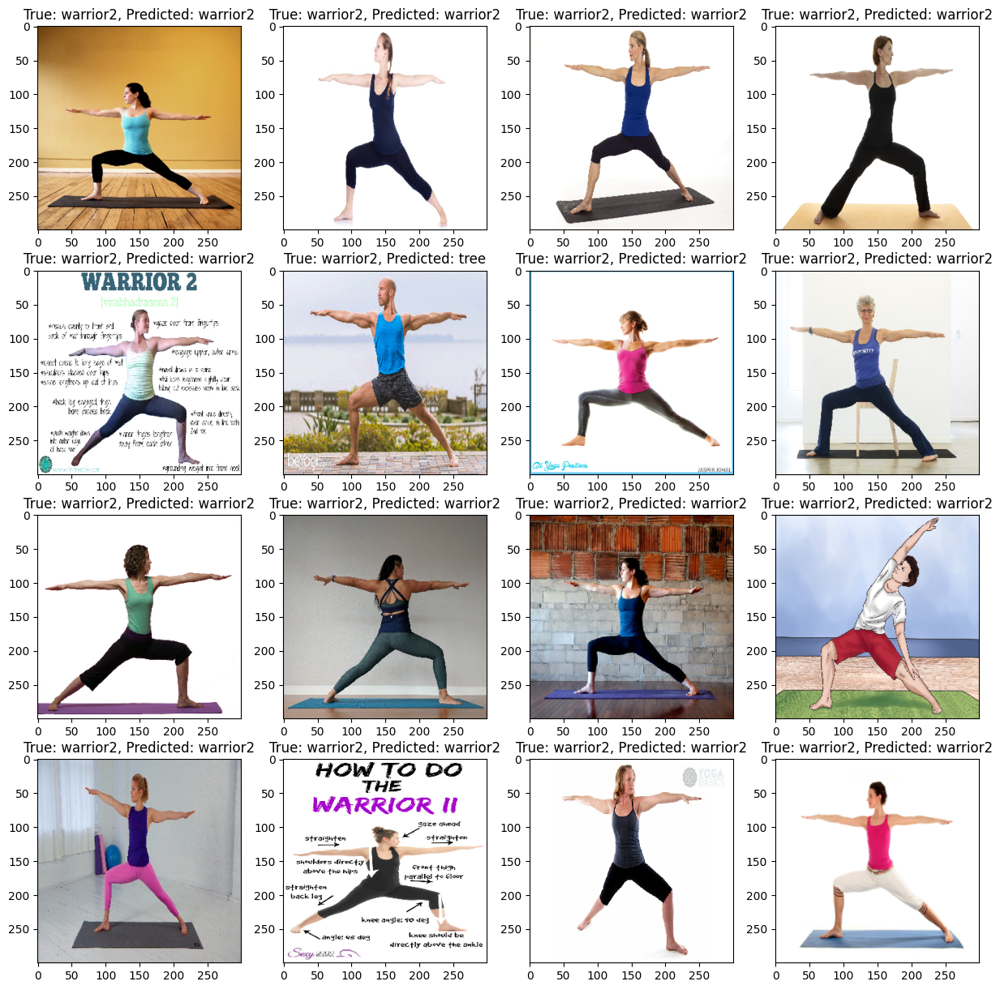

1/1 [==============================] - 0s 425ms/step


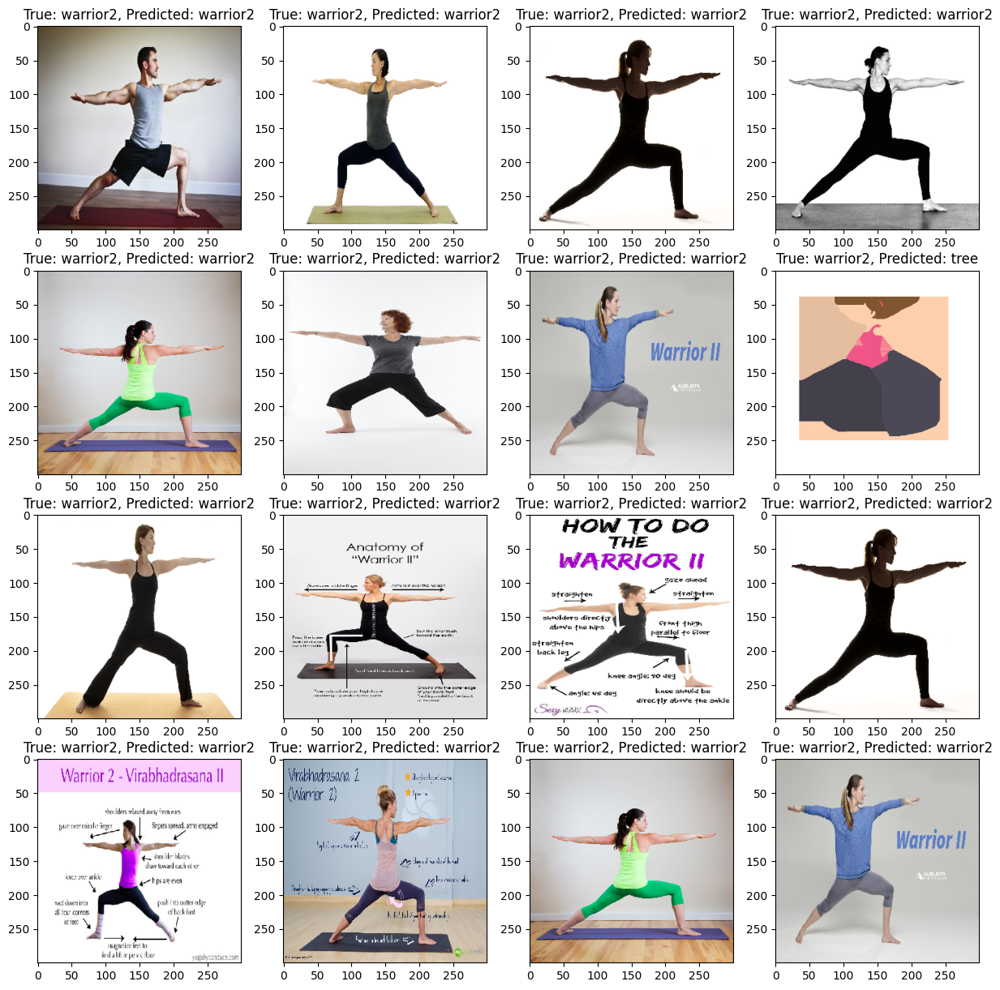

1/1 [==============================] - 0s 404ms/step


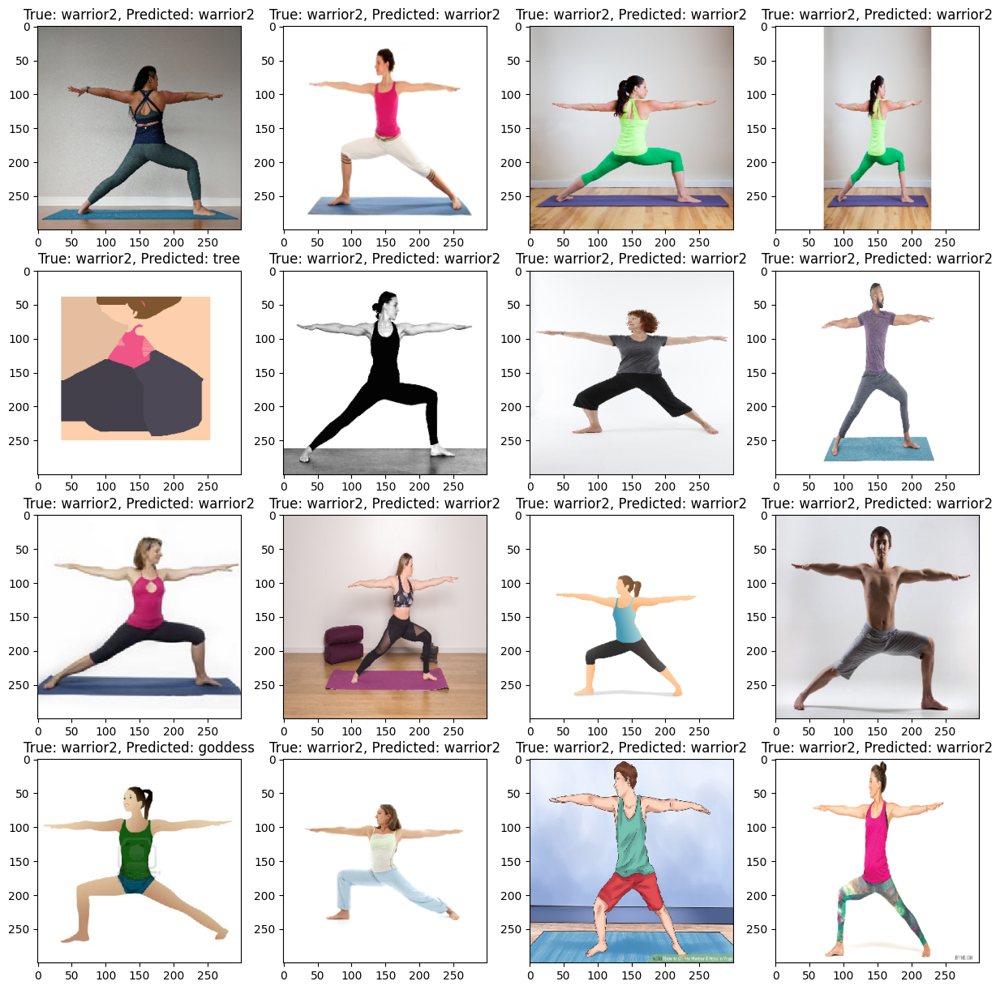

1/1 [==============================] - 0s 409ms/step


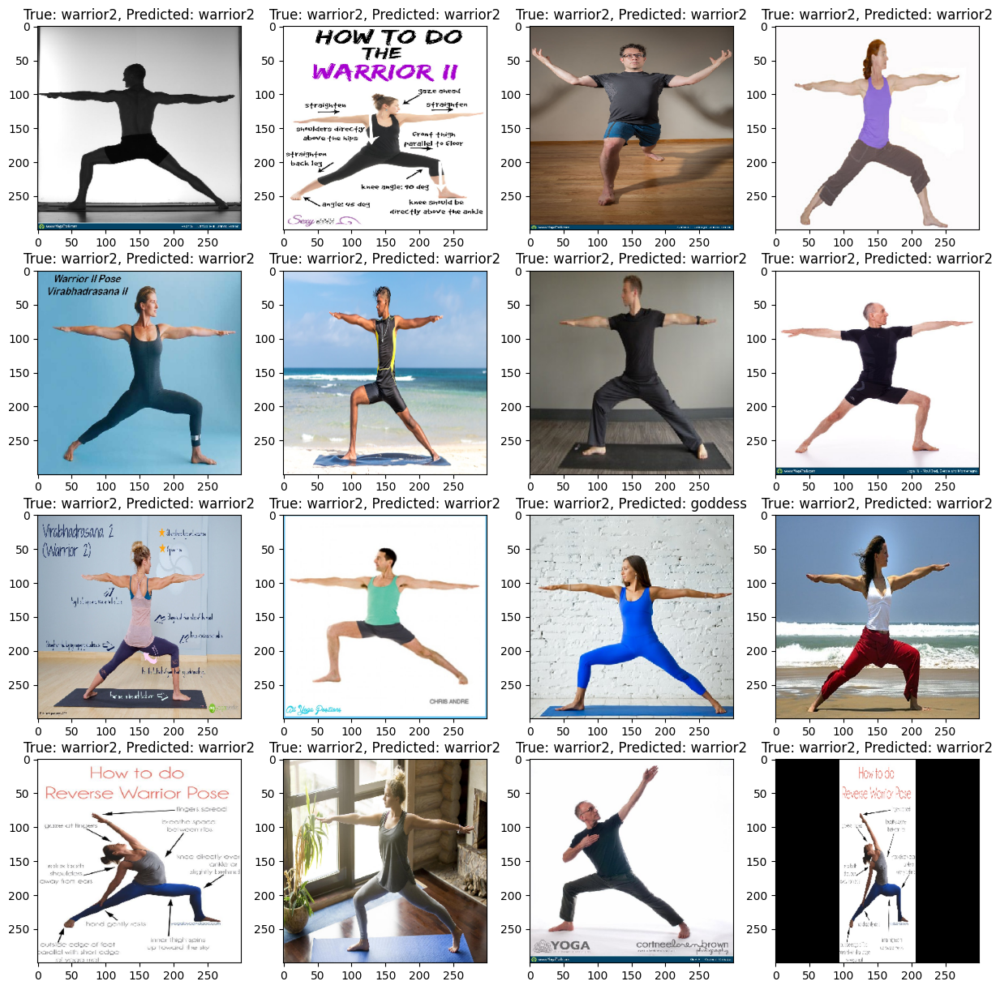

1/1 [==============================] - 0s 404ms/step


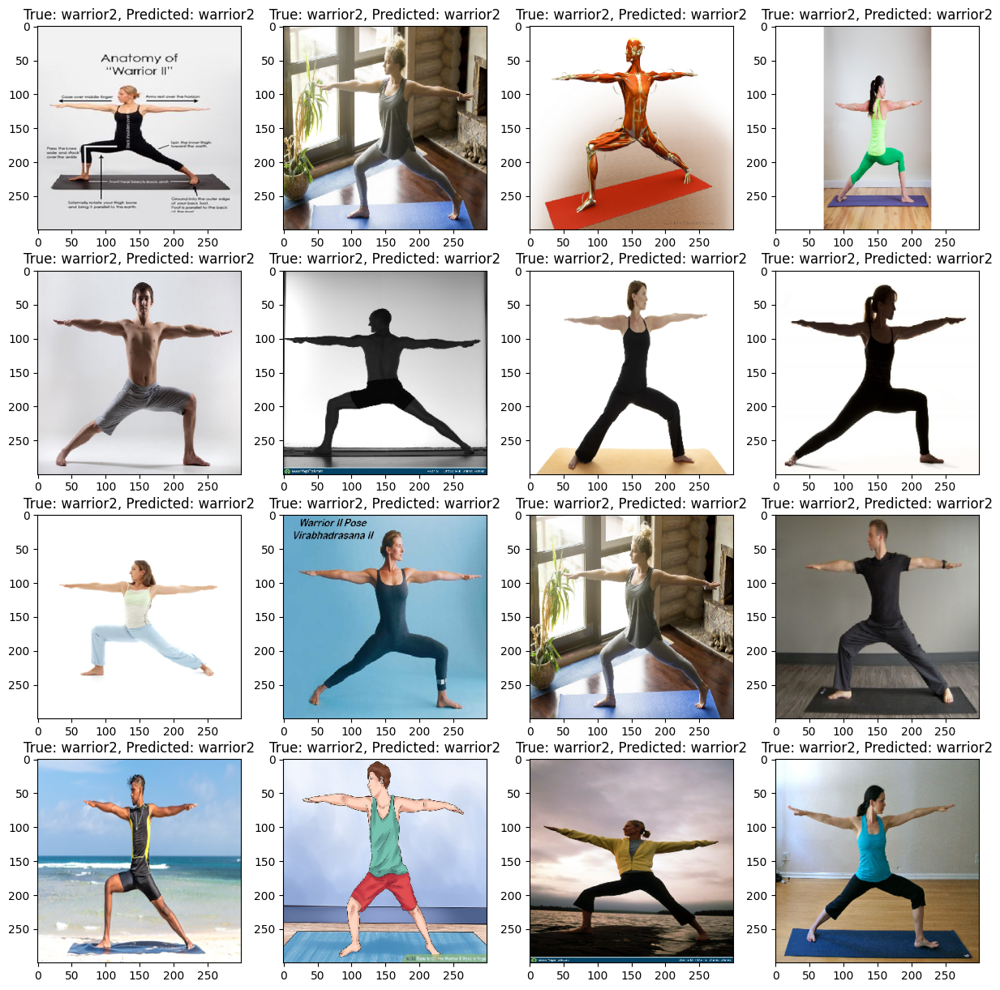

1/1 [==============================] - 0s 427ms/step


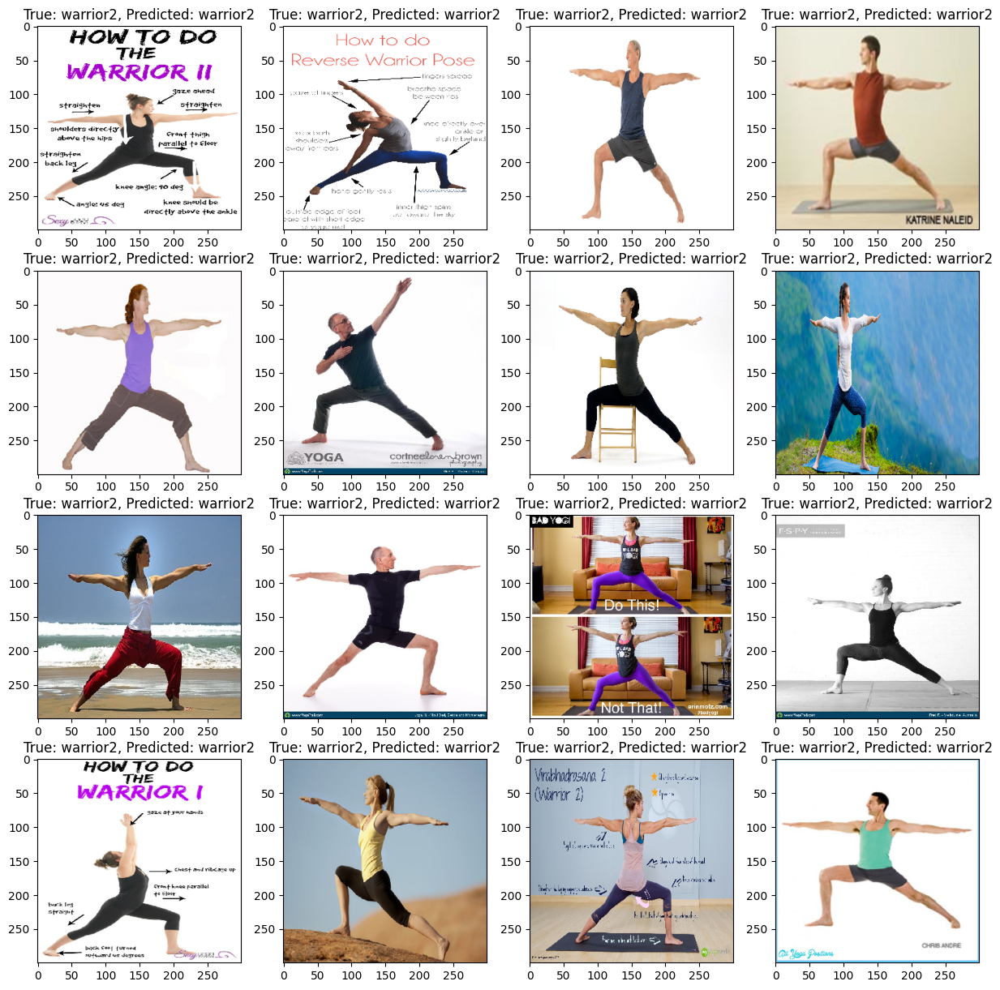

1/1 [==============================] - 0s 347ms/step


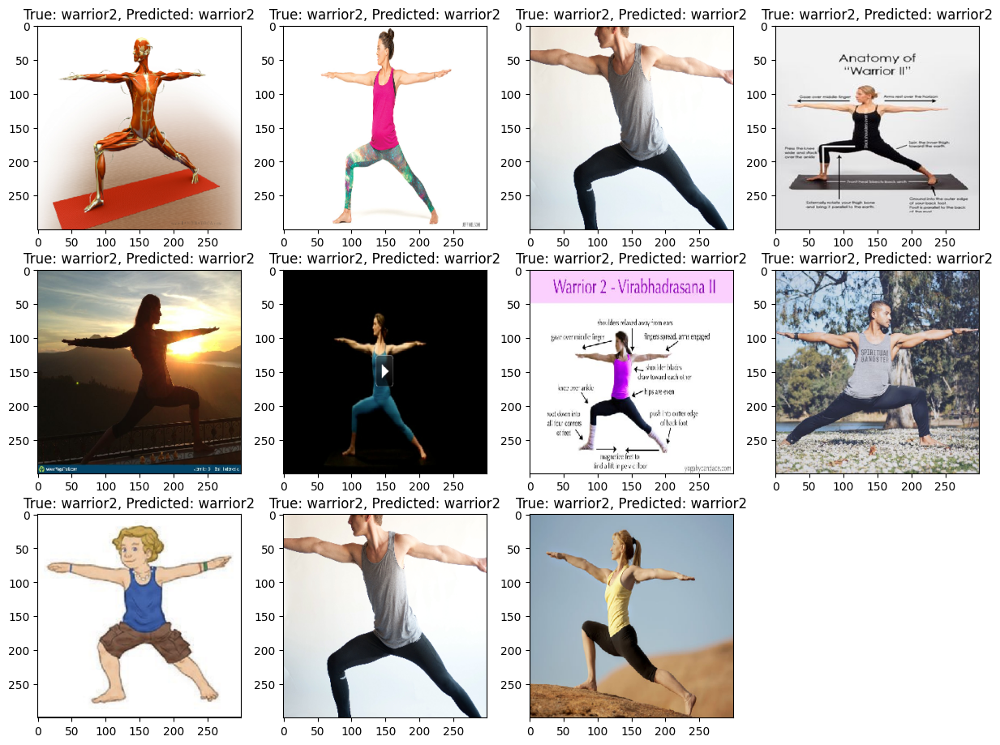

In [ ]:
import matplotlib.pyplot as plt

# Get the class labels
class_labels = list(test_generator.class_indices.keys())

# Iterate over the test generator and display images with their predicted and true classes
for i in range(len(test_generator)):
    # Get batch of images and labels
    batch_images, batch_labels = test_generator[i]

    # Make predictions on the batch
    batch_predictions = model.predict(batch_images)
    batch_predicted_classes = tf.argmax(batch_predictions, axis=1)

    # Display images with their true and predicted classes
    plt.figure(figsize=(15, 15))
    for j in range(len(batch_images)):
        plt.subplot(4, 4, j + 1)
        plt.imshow(batch_images[j])
        plt.title(f"True: {class_labels[np.argmax(batch_labels[j])]}, Predicted: {class_labels[batch_predicted_classes[j]]}")
        plt.axis('on')
    plt.show()
